<a href="https://colab.research.google.com/github/Filip746/OSiRV/blob/main/Osirv_projekt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.exposure import match_histograms

In [ ]:
def load_image(filepath):
    return cv2.cvtColor(cv2.imread(filepath), cv2.COLOR_BGR2RGB)

In [ ]:
def display_images(images, titles, figsize=(15, 5)):
    plt.figure(figsize=figsize)
    for i, (image, title) in enumerate(zip(images, titles)):
        plt.subplot(1, len(images), i + 1)
        plt.imshow(image)
        plt.title(title)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

In [ ]:
def detect_and_match_features(image1, image2):

    orb = cv2.ORB_create()
    keypoints1, descriptors1 = orb.detectAndCompute(image1, None)
    keypoints2, descriptors2 = orb.detectAndCompute(image2, None)

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(descriptors1, descriptors2)
    matches = sorted(matches, key=lambda x: x.distance)

    matched_image = cv2.drawMatches(image1, keypoints1, image2, keypoints2, matches[:10], None, flags=2)
    return matched_image, matches, keypoints1, keypoints2

In [ ]:
def apply_color_correction(source_image, reference_image):
    matched = match_histograms(source_image, reference_image, channel_axis=-1)
    return matched

In [ ]:
image1 = load_image('image1.jpg')
image2 = load_image('image2.jpg')
reference_image = load_image('reference.jpg')

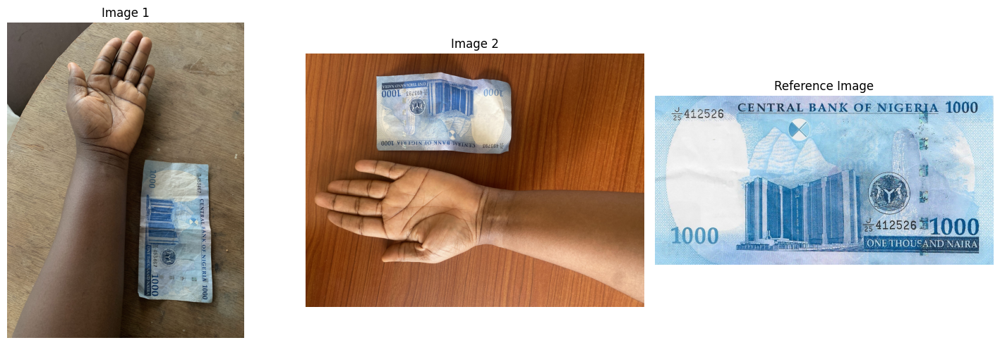

In [ ]:
display_images([image1, image2, reference_image], ['Image 1', 'Image 2', 'Reference Image'])


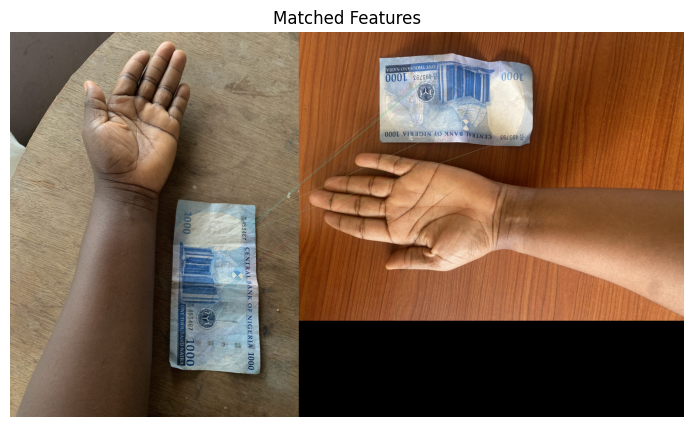

In [ ]:
matched_image, matches, keypoints1, keypoints2 = detect_and_match_features(image1, image2)
plt.figure(figsize=(10, 5))
plt.imshow(matched_image)
plt.title("Matched Features")
plt.axis('off')
plt.show()

In [ ]:
calibrated_image1 = apply_color_correction(image1, reference_image)
calibrated_image2 = apply_color_correction(image2, reference_image)

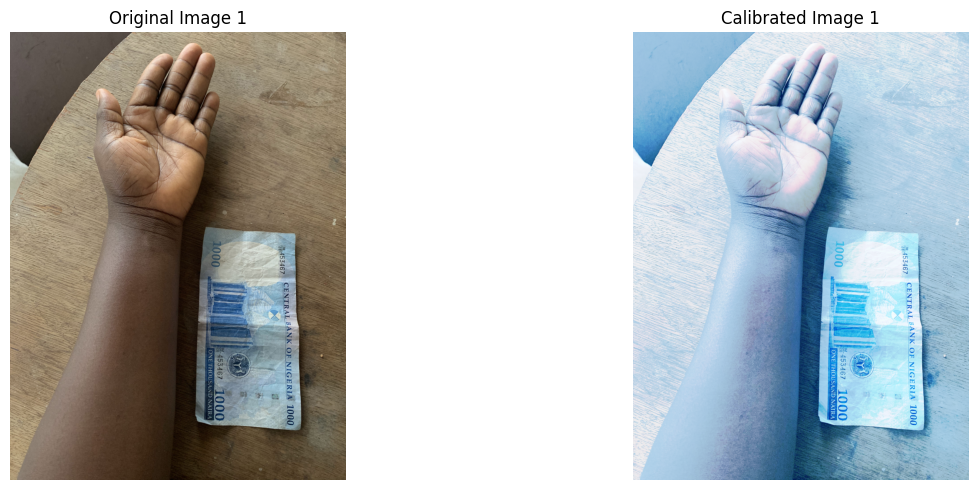

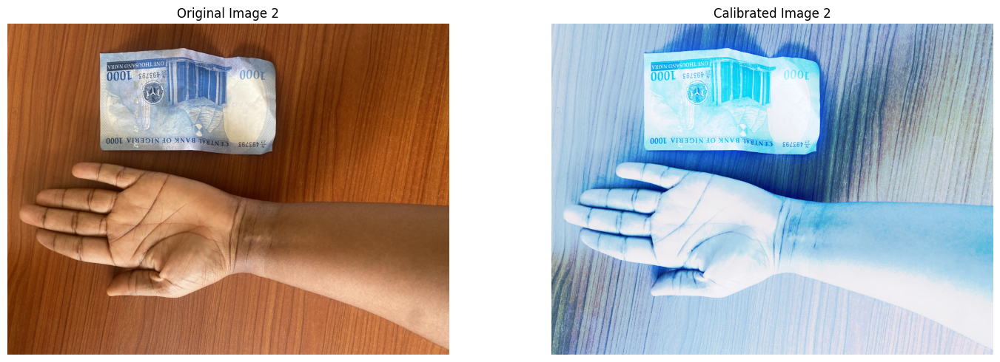

In [ ]:
display_images([image1, calibrated_image1], ['Original Image 1', 'Calibrated Image 1'])
display_images([image2, calibrated_image2], ['Original Image 2', 'Calibrated Image 2'])

In [ ]:
def calculate_color_difference(image1, image2):
    if image1.shape != image2.shape:
        raise ValueError(f"Shapes of images do not match: {image1.shape} vs {image2.shape}")
    diff = np.abs(image1.astype('float') - image2.astype('float'))
    return np.mean(diff)

In [ ]:
original_diff = calculate_color_difference(image1, image2.transpose(1, 0, 2))
calibrated_diff = calculate_color_difference(calibrated_image1, calibrated_image2.transpose(1, 0, 2))

In [ ]:
print(f"Average color difference (original images): {original_diff:.2f}")
print(f"Average color difference (calibrated images): {calibrated_diff:.2f}")

Average color difference (original images): 56.92
Average color difference (calibrated images): 48.18


# Novija verzija se nalazi ispod ovog teksta

In [21]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow

In [23]:
img1 = cv.imread('reference.jpg', cv.IMREAD_GRAYSCALE)
img2 = cv.imread('image1.jpg', cv.IMREAD_GRAYSCALE)

img1_color = cv.imread('reference.jpg')
img2_color = cv.imread('image1.jpg')

In [24]:
MIN_MATCH_COUNT = 10

# Initiate SIFT detector
sift = cv.SIFT_create()

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2)

# store all the good matches as per Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

In [25]:
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

    M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,5.0)
    matchesMask = mask.ravel().tolist()

    h,w = img1.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv.perspectiveTransform(pts,M)

    img2 = cv.polylines(img2,[np.int32(dst)],True,255,3, cv.LINE_AA)

else:
    print( "Not enough matches are found - {}/{}".format(len(good), MIN_MATCH_COUNT) )
    matchesMask = None

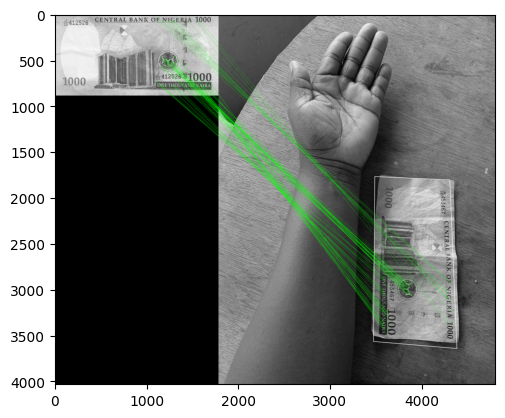

(<matplotlib.image.AxesImage at 0x7b8a342cee10>, None)

In [26]:
draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

img3 = cv.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)

plt.imshow(img3, 'gray'),plt.show()

In [28]:
# Koristim pravokutnik u slici sa bojama
rect_pts = np.int32(dst)  # Točke pravokutnika na slici
rect_pts = rect_pts.reshape(-1, 2)

x, y, w, h = cv.boundingRect(rect_pts)
extracted_region = img2_color[y:y+h, x:x+w]

In [29]:
extracted_region_lab = cv.cvtColor(extracted_region, cv.COLOR_BGR2LAB)

l, a, b = cv.split(extracted_region_lab)

equalized_l = cv.equalizeHist(l)

equalized_region_lab = cv.merge([equalized_l, a, b])

equalized_region_color = cv.cvtColor(equalized_region_lab, cv.COLOR_LAB2BGR)

img2_color[y:y+h, x:x+w] = equalized_region_color

In [30]:
# Primjena histogram equalization na cijelu sliku
img2_lab_full = cv.cvtColor(img2_color, cv.COLOR_BGR2LAB)

l_full, a_full, b_full = cv.split(img2_lab_full)

equalized_l_full = cv.equalizeHist(l_full)

equalized_img2_lab = cv.merge([equalized_l_full, a_full, b_full])

equalized_img2_color = cv.cvtColor(equalized_img2_lab, cv.COLOR_LAB2BGR)


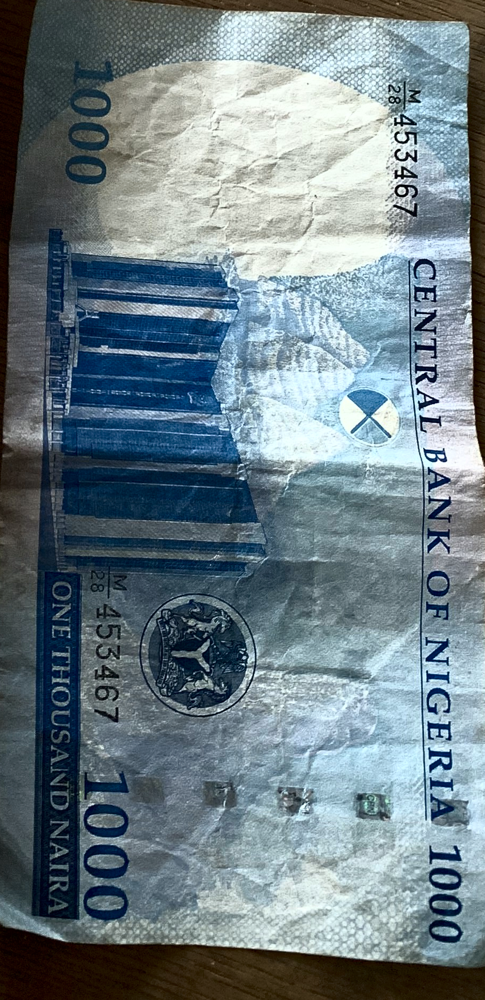

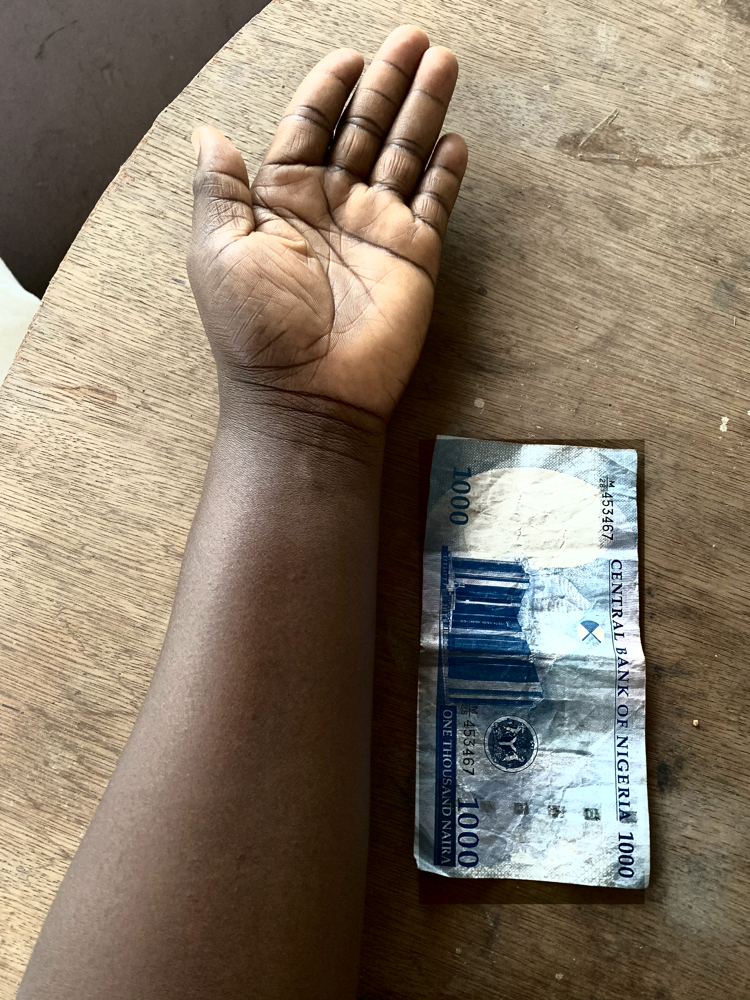

In [31]:
# Samo novčanica
cv2_imshow(equalized_region_color)

# Cijela slika
cv2_imshow(equalized_img2_color)